# Análisis Exploratorio de Alquiler de Departamentos en Santiago de Chile

## Lectura e inspección del dataset
Este dataset fue creado con fines educativos usando web scrappy. extrayendo la data de [portalinmobilario] el objetivo es encontrar relaciones de las variables y su comportamiento que nos permita mejorar la toma de decisión.

### Algunas preguntas exploratorias
- ¿ Cuál es la distribución de los precios de alquiler de los departamentos en arriendo?
- ¿ Cuál es la distribución de los gastos comunes de los departamentos en arriendo?
- ¿ Cuál es el valor promedio, mediana y desviación de la media de los departamentos en arriendo?
- ¿ Cuál es la distribución de las características de los departamentos en arriendo? como número de baños, número de habitaciones, etc.
- ¿ Cuál son los distintos tipo de departamentos?
- ¿ cuáles variables están correlacionadas?
- ¿ Cuál es la distribución de los precios de los departamentos en Arriendo por comuna y region?

- ¿En qué fecha se publicaron más publicaciones de arriendo?






In [11]:
import pandas as pd
import sqlite3
import re
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import numpy as np
import warnings

import json
with open('all.geojson','r') as response:
    geojson = json.load(response)
    
warnings.filterwarnings('ignore') # ingnora los warning
plt.rcParams.update({'font.size': 18})
plt.rcParams['figure.constrained_layout.use'] = True

## Acerca del dataset


In [12]:
#leer el dataset
df = pd.read_csv('clean_alquiler_02_11_2023cc.csv')
#canviar el formato de precio y gastos comunes pasa de esto (500000) a esto (500) mil pesos
df[['precio','gastos_comunes']] = df[['precio','gastos_comunes']].applymap(lambda x: float('{0:.3f}'.format(x/1e3)))

In [13]:
#eliminamos columnas que no son utiles
df.drop(columns=['id','link','estacionamientos','bodegas','codigo','published_time'],inplace=True)
df.head(2)

,Unnamed: 0,titulo,precio,direction,superficie_total,superficie_util,superficie_terraza,ambientes,dormitorios,banos,...,cantidad_pisos,departamentos_piso,numero_piso_unidad,fecha,latitude,longitude,comuna,published,divisa,region
0,0,edificio av. departamental- vista norte piso 16,400.0,"av. departamental 900 - 1200, lo vial, san miguel",34.0,34.0,0.0,3,2,1,...,23,13,16,2023-02-11 00:00:00.000000,-33.504288,-70.650536,San miguel,2023-02-10 17:56:38.667783,pesos,Rm (metropolitana)
1,1,edificio garcía reyes- vista poniente piso 5,410.0,"garcía reyes 1 - 300, barrio yungay, santiago",5438.0,52.0,2.0,3,2,1,...,5,24,5,2023-02-11 00:00:00.000000,-33.444885,-70.670891,Santiago,2023-02-10 17:56:38.667831,pesos,Rm (metropolitana)


In [14]:
# columnas con valores nulos
df.isnull().sum()


Unnamed: 0                0
titulo                   39
precio                    0
direction                 0
superficie_total          0
superficie_util           0
superficie_terraza        0
ambientes                 0
dormitorios               0
banos                     0
cant_max_habitantes       0
gastos_comunes            0
orientacion            1944
tipo_departamento      1021
cantidad_pisos            0
departamentos_piso        0
numero_piso_unidad        0
fecha                     0
latitude                390
longitude               390
comuna                    0
published                 0
divisa                    0
region                    0
dtype: int64

In [15]:
df =df[df.divisa=='pesos']

In [16]:
def _visualizar_freq(df,column,titulo):
    # Bar-plots/Histograms
    # define subplot grid
    fig, axs = plt.subplots(nrows=4, ncols=2, figsize=(17, 13))
    plt.subplots_adjust(hspace=0.5)
    fig.suptitle(titulo, fontsize=18, y=0.95)

    # loop through tickers and axes
    for column, ax in zip(columns, axs.ravel()):
        # filter df for ticker and plot on specified axes
        if df[column].dtype == 'int64':
            df[df[column] > 0][column].value_counts().plot(kind="bar",ax=ax)
        else:
            df[df[column] > ''][column].value_counts().plot(kind="bar",ax=ax)
        #filter_col
        #sns.catplot(x=filter_col, kind='count', data=df,ax=ax)
        # chart formatting
        ax.set_title(column.upper())
        #ax.get_legend().remove()
        #ax.set_xlabel("")
    plt.savefig(f"freq_{column}.png")
    plt.show()

In [17]:

def _visualizar_distribucion(data,column):
    g = sns.displot(data=data, x=column, kde=True)
    for ax in g.axes.ravel():
    
        # add annotations
        for c in ax.containers:

            # custom label calculates percent and add an empty string so 0 value bars don't have a number
            labels = [f'{w:0.2f}' if (w := v.get_x()) > 0  else '' for v in c]
            #labels = [v.get_x() if v.get_x() > 0 else '' for v in c]
            ax.bar_label(c, labels=labels, label_type='edge', fontsize=8, rotation=90, padding=2)

        ax.margins(y=0.2)

    g.fig.set_figwidth(18.27)
    g.fig.set_figheight(6.7)
    plt.savefig(f"distribucion_{column}.png")

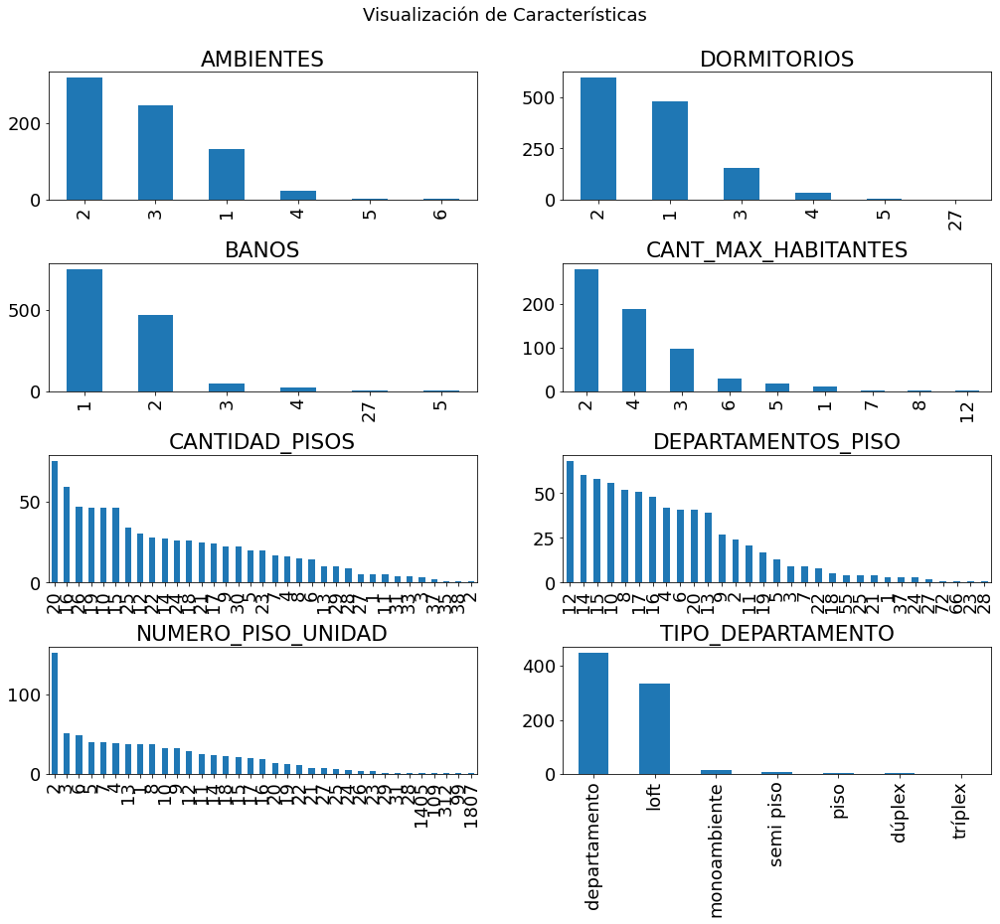

In [18]:

columns = ["ambientes", 
           "dormitorios", 
           "banos", 
           "cant_max_habitantes", 
           "cantidad_pisos",
           "departamentos_piso",
           "numero_piso_unidad",
           "tipo_departamento"
          ]
titulo = "Visualización de Características" 

_visualizar_freq(df,columns,titulo)


### - ¿Cuál es la distribución de las características de los departamentos en Arriendo?, como número de baños, número de habitaciones, etc.
La cantidad de publicaciones tiene:
- 2 Ambientes
- 2 Dormitorios
- 1 Baño
- 2 habitantes máximos
- La mayoría de los departamentos tiene 20 pisos. Seguidos de 16 pisos
- El piso más frecuente en la publicación es el piso 12 seguido del 14
- La mayoría de los departamentos son tipo departamento seguido de Lot 

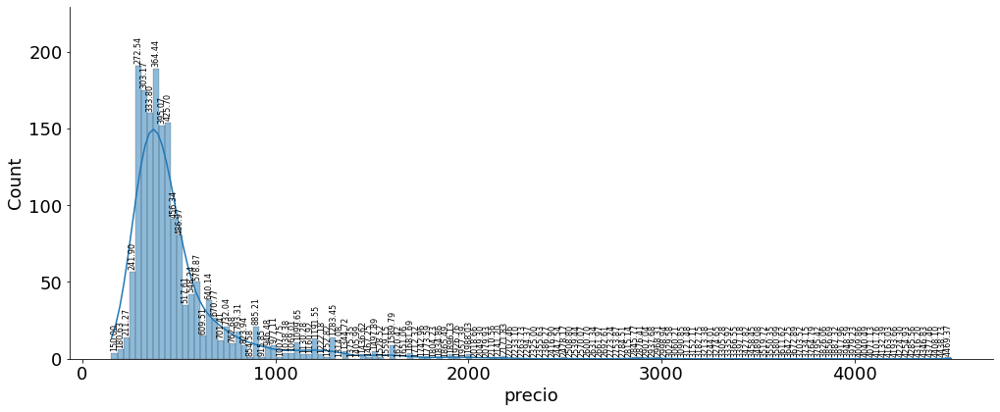

In [19]:
precio = df[df['precio'] > 0]
_visualizar_distribucion(precio,'precio')

In [20]:

def _visualizar_dist_interativo(data,column):
    fig = px.histogram(data, x=column, marginal="rug")
    fig.show()

### - ¿Cuál es la distribución de los precios de alquiler de los departamentos en Arriendo?
La distribución de los precios de alquiler se concentra de 275 a 524 mil pesos chilenos. En mi caso estoy dentro del área de mayor densidad con pagando 470 mil pesos


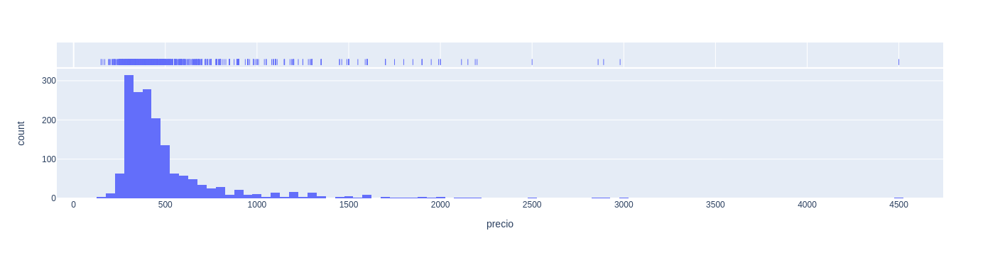

In [21]:

_visualizar_dist_interativo(precio,'precio')

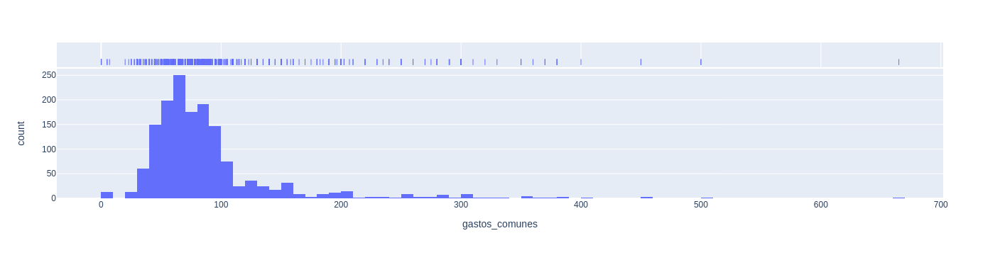

In [22]:
gastos_comunes = df[df.gastos_comunes > 0]
_visualizar_dist_interativo(gastos_comunes,'gastos_comunes')

### - ¿ Cuál es la distribución de los gastos comunes en arriendo?
como en el precio. Los gastos comunes se encuentra sesgado a la izquierda con una mayor densidad de 50 a 60 mil pesos chilenos. 
De nuevo en mi caso estoy dentro del área más densa. Pagando 50 mil pesos


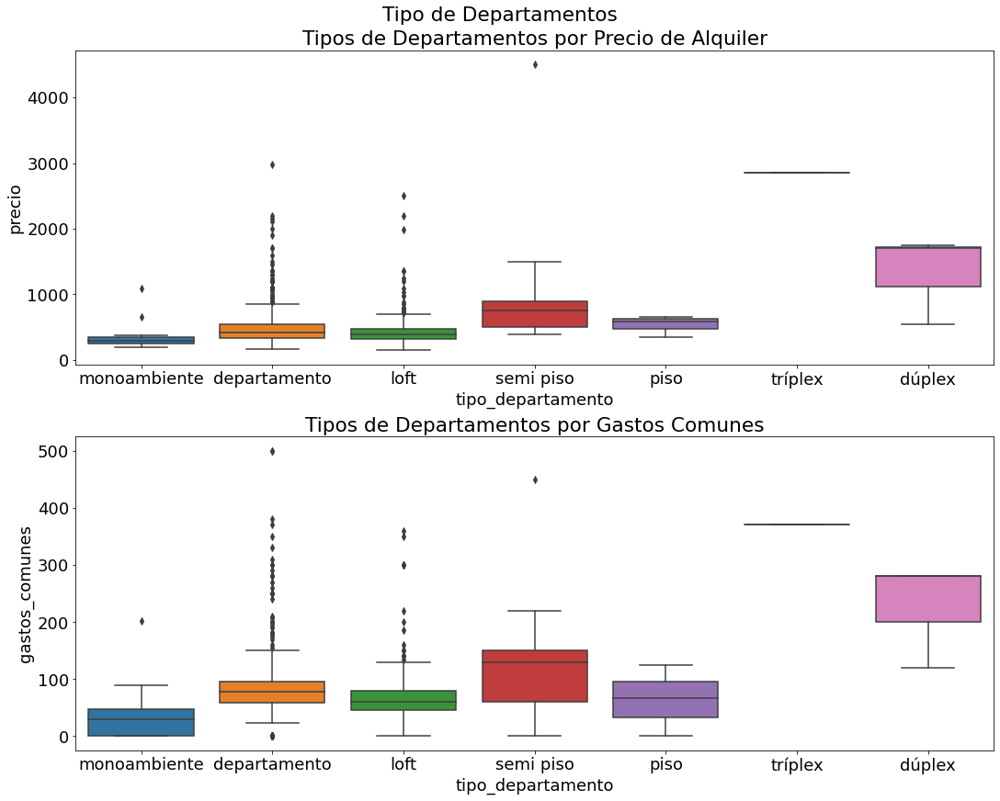

In [23]:
plt.rcParams['figure.constrained_layout.use'] = True
figure, axs = plt.subplots(2,1,figsize=(15,12))
axs = axs.flatten()
figure.suptitle('Tipo de Departamentos')
axs[0].set_title('Tipos de Departamentos por Precio de Alquiler')
axs[1].set_title('Tipos de Departamentos por Gastos Comunes')
sns.boxplot(x="tipo_departamento", y="precio", data=df,ax=axs[0]) # pass ax1

sns.boxplot(x="tipo_departamento", y="gastos_comunes", data=df,ax=axs[1]) # pass ax2


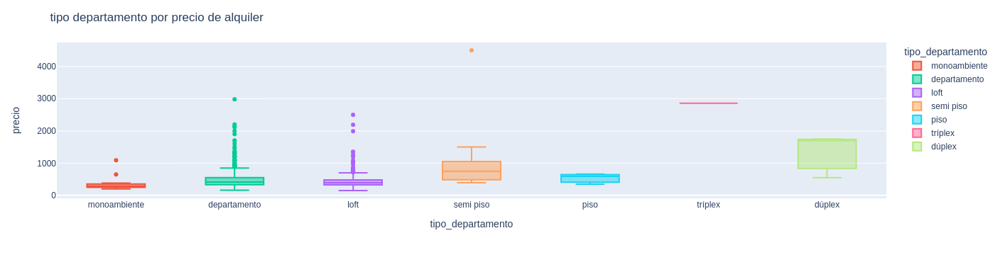

In [24]:
def box_visualizacion(df,x,y,titulo):
    fig = px.box(df, x=x, y=y,color=x)
    fig.update_layout(title_text=titulo)
    fig.show()
    
box_visualizacion(df,x='tipo_departamento',y='precio',titulo="tipo departamento por precio de alquiler")

### - ¿Cuál es la distribución de los precios de los departamentos en arriendo por tipo de departamento?

Los tipos triplex y penthouse son los menos frecuentes, mientras el tipo departamento tienen una mayor cantidad de valores atípicos. Los que tienen una mayor cantidad de variabilidad son duplex, piso y semi piso. Lo cual significa que su rango de precio y gastos comunes es más amplia. 
Finalmente departamento y loft tiene una menor variabilidad su rango de precio es menor


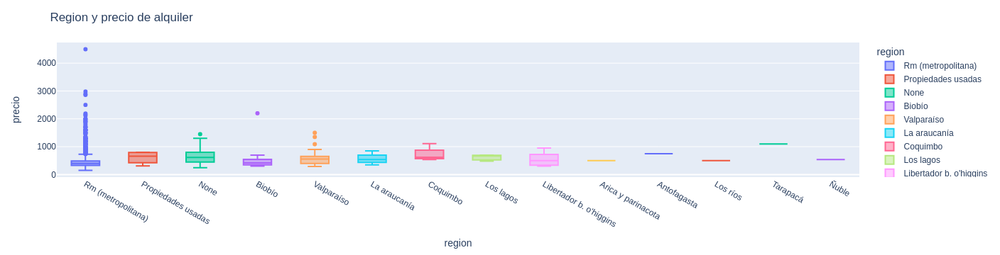

In [25]:
box_visualizacion(df,x='region',y='precio',titulo="Region y precio de alquiler")

### - ¿ Cuál es la distribución de los precios de los departamentos en arriendo por Region?
la región con mayor variabilidad en precio es de Tarapaca, mientras región metropolitana tiene la mayor de valores atípicos y una mediana de  380 mil pesos (valor de la mitad) en mi caso 
estoy ubicado en el tercer quantir

### - ¿ Cuál es la distribución de los precios de los departamentos en arriendo por comuna en Región Metropilitana?

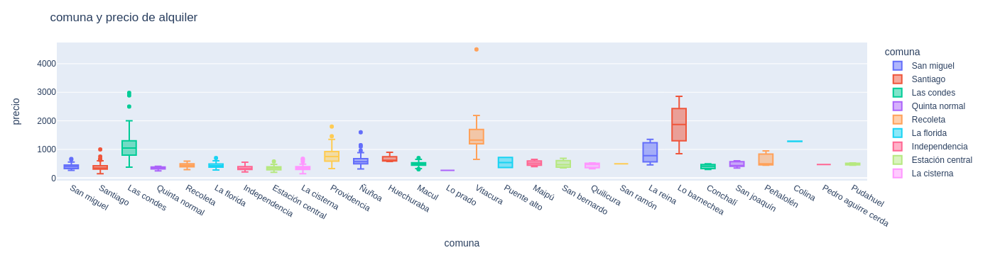

In [26]:
comuna_santiago =df[df['region']=='Rm (metropolitana)']
box_visualizacion(comuna_santiago,x='comuna',y='precio',titulo="comuna y precio de alquiler")

## - Análisis Geográfico


### - ubicación geografica por precio

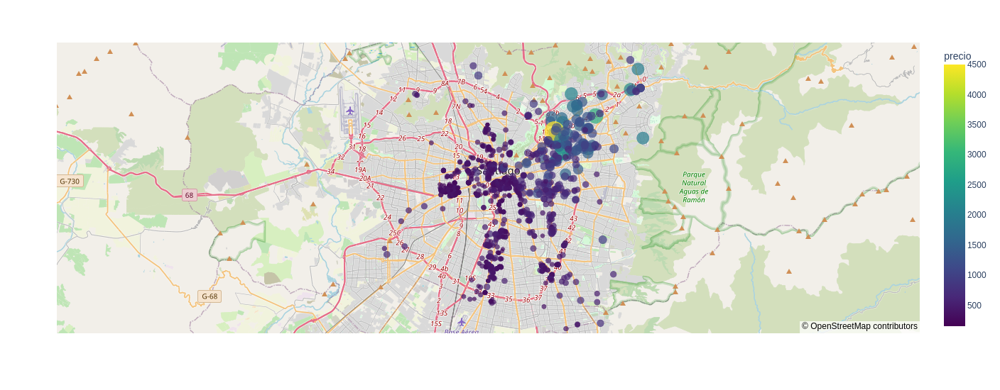

In [27]:
fig = px.scatter_mapbox(df, lat="latitude", lon="longitude", hover_name="titulo", hover_data=["titulo", "precio","gastos_comunes"],
                        color="precio", color_continuous_scale='Viridis', zoom=10, height=550,size="precio",center=dict(lon=-70.660, lat=-33.452))
fig.update_layout(mapbox_style="open-street-map")
#fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## - ubicación geografica por gastos comunes 

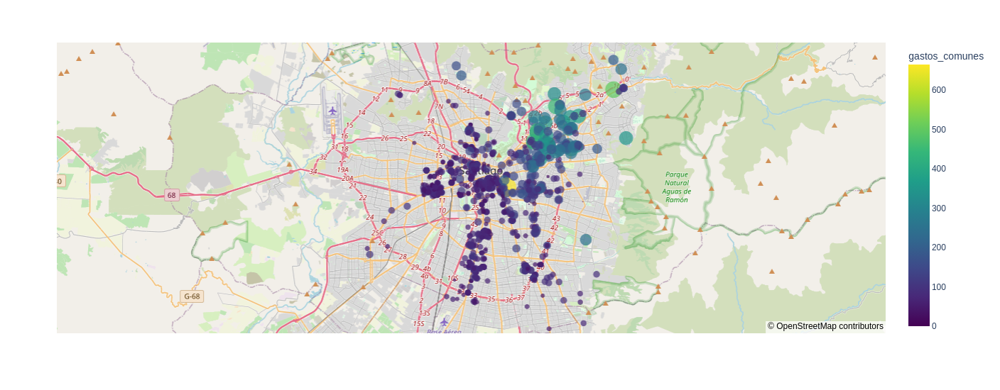

In [28]:
fig = px.scatter_mapbox(df, lat="latitude", lon="longitude", hover_name="titulo", hover_data=["titulo",'direction',"precio","gastos_comunes"],
                        color="gastos_comunes", color_continuous_scale='Viridis', zoom=10, height=550,size="gastos_comunes",center=dict(lon=-70.660, lat=-33.452))
fig.update_layout(mapbox_style="open-street-map")
#fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

### - Precio promedio por comuna 

In [29]:
comuna_santiago =df[df['region']=='Rm (metropolitana)']
precio_promedio_comuna = comuna_santiago.groupby("comuna")['precio'].agg([np.mean,np.median])
precio_promedio_comuna.style.highlight_max()

,mean,median
comuna,,
Colina,1285.000000,1285.000000
Conchalí,402.149333,411.448000
Estación central,340.769258,342.000000
Huechuraba,686.923077,603.000000
Independencia,346.517857,322.500000
La cisterna,364.142407,350.000000
La florida,431.560606,427.000000
La reina,878.000000,780.000000
Las condes,1123.188989,1050.000000


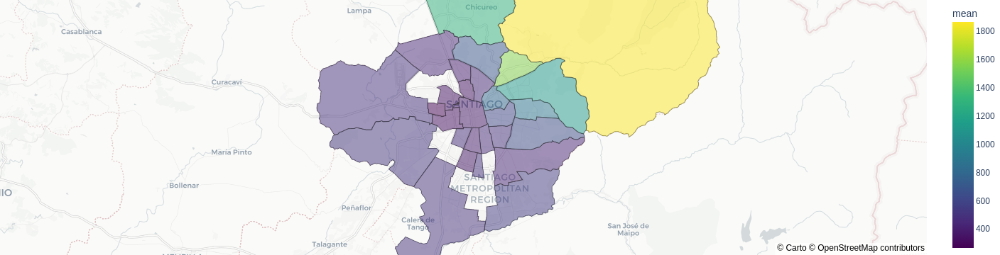

In [30]:
precio_promedio_comuna.reset_index(inplace=True)
fig = px.choropleth_mapbox(precio_promedio_comuna, geojson=geojson, locations='comuna',
                           featureidkey="properties.NOM_COM",
                           color_continuous_scale="Viridis",
                           color='mean', 
                           center=dict(lon=-70.67159, lat=-33.47636),


                           mapbox_style="carto-positron",
                           zoom=9,
                           opacity=0.5,
                           #labels={'unemp':'unemployment rate'}
                           )
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})

### - mediana de precio por comuna o valor de la mitad

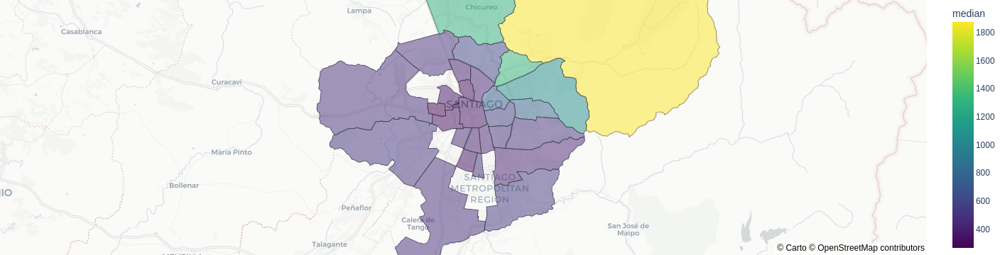

In [31]:
fig = px.choropleth_mapbox(precio_promedio_comuna, geojson=geojson, locations='comuna',
                           featureidkey="properties.NOM_COM",
                           color_continuous_scale="Viridis",
                           color='median', 
                           center=dict(lon=-70.67159, lat=-33.47636),


                           mapbox_style="carto-positron",
                           zoom=9,
                           opacity=0.5,
                           #labels={'unemp':'unemployment rate'}
                           )
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})

#### nota: **Estos datos son referenciales y aunque son reales lo estoy tomando de una sola fuente. además si hay pocas publicaciones en una comuna esto pude sesgar el precio. Por eso cuidado con la interpretación** 
con este resultado puedes ver si el precio del arriendo esta por debajo o por encima de la media de cada comuna y así tener un mejor criterio a la hora de escoger un departamento si estás pagando por debajo o por encima del promedio.
también te permite comparar los distintos niveles de vida de las comunas (asumo la relación de precio promedio y capacidad adquisitiva aunque en este análisis no lo pruebo)

## - Análisis de las variables Quantitativas (numericas)

In [32]:
quantitative = [feature for feature in df.columns if df.dtypes[feature] != 'object' and len(df[feature].unique())>10 ]
quantitative.remove('latitude')
quantitative.remove('longitude')
qualitative = [feature for feature in df.columns if not (df.dtypes[feature] != 'object' and len(df[feature].unique())>10)]
qualitative.remove('direction')
qualitative.remove('titulo')
#qualitative.remove('precio')
#qualitative.remove('superficie_terraza')

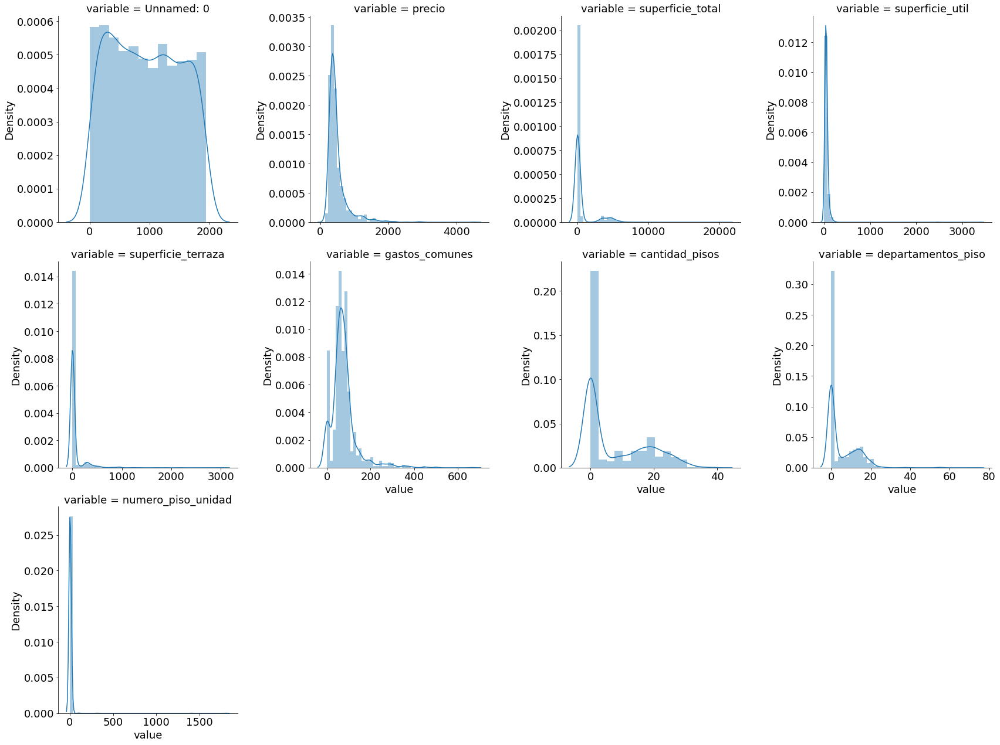

In [33]:
m_cont = pd.melt(df, value_vars=quantitative)
g = sns.FacetGrid(m_cont, col='variable', col_wrap=4, sharex=False, sharey=False, size = 6)
g.map(sns.distplot, 'value')

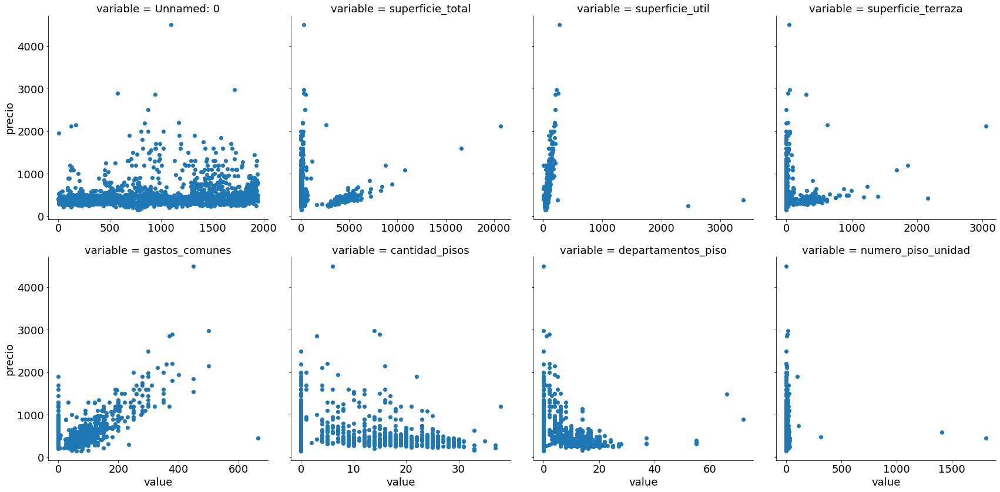

In [34]:
m_cont = pd.melt(df, id_vars='precio', value_vars=quantitative)
g = sns.FacetGrid(m_cont, col='variable', col_wrap=4, sharex=False, sharey=True, size = 6)
g.map(plt.scatter, 'value', 'precio')

### - Correlaciones entre las variables 

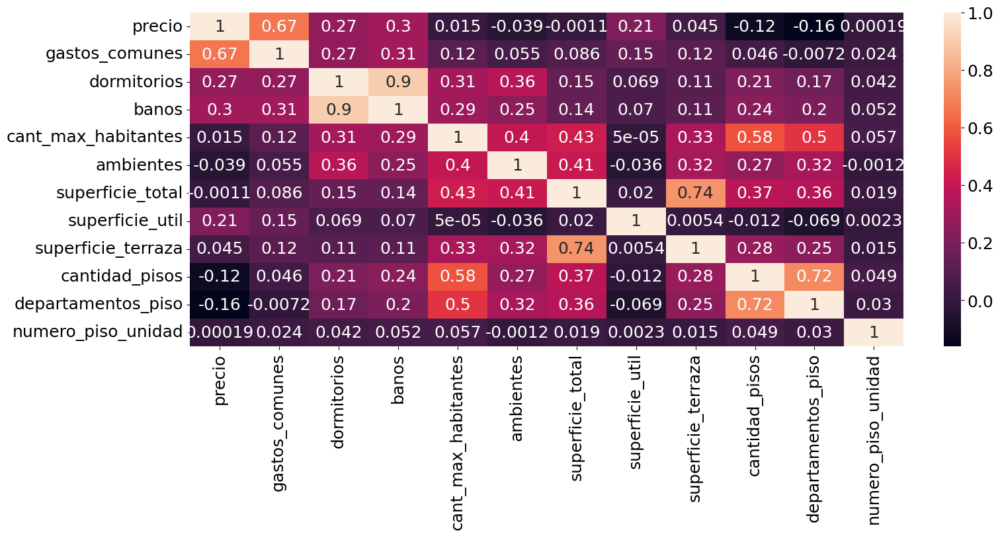

In [35]:
columns = [ 
    'precio',
    'gastos_comunes',
    'dormitorios',
    'banos',
    'cant_max_habitantes',
    'ambientes',
    'superficie_total',
    'superficie_util',
    'superficie_terraza',
    'cantidad_pisos',
    'departamentos_piso',
    'numero_piso_unidad']


fig, ax = plt.subplots(figsize=(15, 8), dpi=100)
ax = sns.heatmap(df[columns].corr(), annot=True)




Se observa una baja correlación del precio de alquiler con las demás variables. Siendo los gastos comunes con apenas un 67 % de relación con el precio. Aun así la variable baños está fuertemente relacionada con la cantidad de dormitorios, seguido de superficie total y la superficie de la terraza. Esto lo que quiere decir es que están relacionadas así por ejemplo si un departamento tiene más baños entonces también tiene más habitaciones.


## - Análisis de Tiempo

In [36]:
df['published'] = pd.to_datetime(df['published'])
dfx = df.set_index('published') 
month_summary = dfx[['precio']].resample('M').transform('mean')
#date_frame = df.set_index(['published'])
#df.precio.resample('Y').mean()
#date_frame.head()
month_summary.reset_index(inplace=True)
month_summary
#df['published'].unique()


,published,precio
0,2020-08-05 17:56:38.677033,1590.000000
1,2021-02-21 17:56:38.676124,1600.000000
2,2022-06-12 17:56:38.675469,306.000000
3,2022-07-12 17:56:38.674958,454.000000
4,2022-09-12 17:56:38.669202,413.333333
...,...,...
1689,2023-02-12 17:56:38.678312,517.556084
1690,2023-02-12 17:56:38.678313,517.556084
1691,2023-02-12 17:56:38.678314,517.556084
1692,2023-02-12 17:56:38.678315,517.556084


In [37]:
month_summary.reset_index(inplace=True)

def scatter_visualizacion(df,x,y,color=None):
    fig = px.scatter(df, x=x, y=y, color=color)

    fig.update_traces(marker=dict(size=12,
                                  line=dict(width=2,
                                            color='DarkSlateGrey')),
                      selector=dict(mode='markers'))
    fig.show()

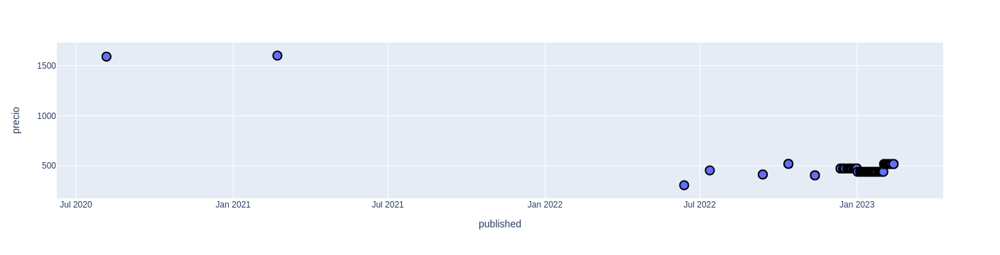

In [38]:
scatter_visualizacion(month_summary,'published','precio')

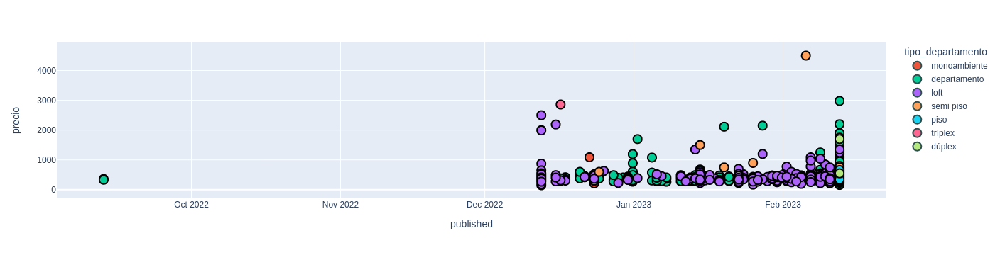

In [39]:
scatter_visualizacion(df,'published','precio',color="tipo_departamento")


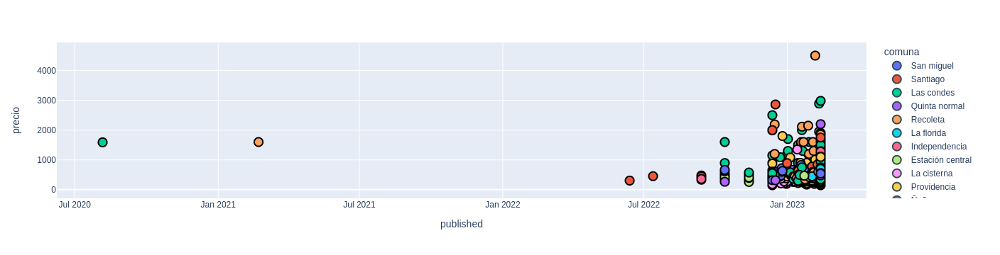

In [40]:
scatter_visualizacion(df,'published','precio',color="comuna")

## - Algunas curiosidades 
Seguro te estarás preguntando cuál es el departamento más caro para arriendo o el más económico. cuál tiene los gastos comunes más costosos o permite la mayor cantidad de habitantes

buenos veamos 


### - departamento precio más costosos

In [41]:
#precio = df[df['precio'] > 0]
features = ['titulo','precio','gastos_comunes','direction','tipo_departamento','comuna','superficie_total','cant_max_habitantes']
#precio['precio'].value_counts().sort_values(ascending=False)
#publicacion con el arriendo mas caro 

# https://www.portalinmobiliario.com/MLC-1313691389-la-nieves-paul-claudel-av-presidente-kennedy-_JM
dx = df['precio'].max()
df[df['precio'] == dx][features]

,titulo,precio,gastos_comunes,direction,tipo_departamento,comuna,superficie_total,cant_max_habitantes
1097,NaN,4500.0,450.0,la nieves/ paul claudel/ av. presidente kenned...,semi piso,Vitacura,304.0,0


### - departamento gastos comunes más costosos

In [42]:
#https://www.portalinmobiliario.com/MLC-1284972082-departamento-en-arriendo-de-2-dorm-en-las-condes-_JM#position=11&search_layout=stack&type=item&tracking_id=69a4662e-e18d-4f67-ae9a-cbf9de602df3
dx = df['gastos_comunes'].max()
df[df['gastos_comunes'] == dx][features]

,titulo,precio,gastos_comunes,direction,tipo_departamento,comuna,superficie_total,cant_max_habitantes
215,edificio emilio vaisse- vista poniente piso 29,460.0,665.0,"emilio vaisse 600 - 900, metro irarrázaval, ñuñoa",NaN,Ñuñoa,4115.0,2


### - departamento con la mayor cantidad máxima de habitantes

In [43]:
dx = df['cant_max_habitantes'].max()
df[df['cant_max_habitantes'] == dx][features]

,titulo,precio,gastos_comunes,direction,tipo_departamento,comuna,superficie_total,cant_max_habitantes
1324,edificio fundadores - entrega inmediata - 4 dorm,1900.0,280.0,"callao 3600 - 3900, las condes, chile, barrio ...",departamento,Las condes,136.0,12


# Machine learning (ML) - Predicción de alquiler de Departamentos

In [46]:
from sklearn.model_selection import train_test_split

# con esto vamos a ver cual es la precisión de nuestro modelo en porcentaje.
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_regression
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

#scaler = MinMaxScaler(feature_range=(0, 1))
#X = scaler.fit_transform(X)

df.fillna(0,inplace=True)
x = np.asanyarray(df.drop(columns=['divisa','precio','titulo','direction','fecha','published','tipo_departamento','region','comuna']))
y = np.asanyarray(df[['precio']])



In [47]:

xtrain, xtest, ytrain, ytest = train_test_split(x,y)
#Ahora viene el momento de separar la información 80 -20, normalmente es lo utilizado para entrenar modelos, separar de manera aleatoria los datos 80% para entrenar y 20% para testing.

In [48]:
regr = RandomForestRegressor(max_depth=4, random_state=0)
regr.fit(xtrain,ytrain)
resultado = regr.score(xtest, ytest)
print(resultado)


0.8457397736287195


In [ ]:
predicciones = regr.predict(X = xtest)
rmse = mean_squared_error(
        y_true  = ytest,
        y_pred  = predicciones,
        squared = False
       )
print(f"El error (rmse) de test es: {rmse}")